# Wykrywanie naczynek w dnie oka
Przedmiot: Informatyka w medycynie 

Michał Parszyk 148115
Mikołaj Pająk 148183

# Dane początkowe
Importowanie potrzebnych bibliotek

In [4]:
from skimage import io, color, transform, filters, draw, exposure, img_as_float
from skimage.filters import unsharp_mask, gaussian, median, frangi, sato, threshold_otsu
from skimage.color.colorconv import rgb2gray
from sklearn.feature_extraction.image import reconstruct_from_patches_2d
import cv2
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report
from sklearn.feature_extraction.image import extract_patches_2d
from skimage.measure import moments_central,moments as skimage_moments, moments_hu,moments_normalized,moments_central
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from imblearn.under_sampling import RandomUnderSampler
from sklearn.tree import DecisionTreeClassifier
import pickle


# Ładowanie i prezentacja początkowa zdjęć 

<Figure size 2000x1500 with 0 Axes>

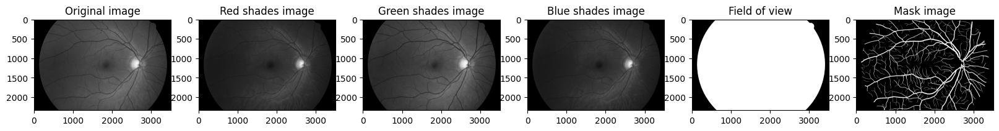

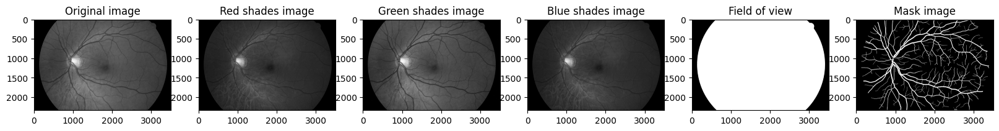

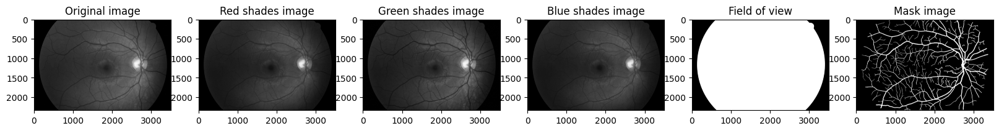

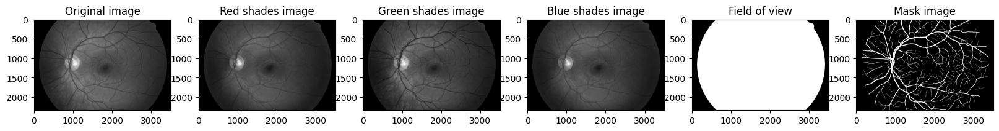

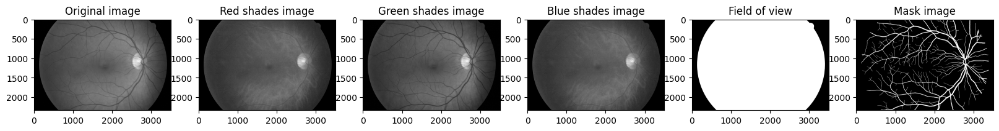

In [ ]:
fig = plt.figure(figsize=(20, 15))
rows = 1
cols = 6
for i in range(1, 6):
  fig = plt.figure(figsize=(20, 15))
  # load original img
  img = cv2.imread(f"0{i}_h.jpg")

  fig.add_subplot(rows, cols, 1)
  plt.imshow(rgb2gray(img), cmap="gray")
  plt.title("Original image")

  img_red = img.copy()
  img_grn = img.copy()
  img_blu = img.copy()

  # img in diffrent shades
  img_red[:,:,2] = 0
  img_red[:,:,1] = 0
  img_red = rgb2gray(img_red / 255)

  fig.add_subplot(rows, cols, 2)
  plt.imshow(img_red, cmap="gray")
  plt.title("Red shades image")

  img_grn[:,:,0] = 0
  img_grn[:,:,2] = 0
  img_grn = rgb2gray(img_grn / 255)

  fig.add_subplot(rows, cols, 3)
  plt.imshow(img_grn, cmap="gray")
  plt.title("Green shades image")

  img_blu[:,:,0] = 0
  img_blu[:,:,2] = 0
  img_blu = rgb2gray(img_blu / 255)

  fig.add_subplot(rows, cols, 4)
  plt.imshow(img_red, cmap="gray")
  plt.title("Blue shades image")

  # img field of view
  img_fov = cv2.imread(f"0{i}_h_mask.tif")
  img_fov = rgb2gray(img_fov / 255)

  fig.add_subplot(rows, cols, 5)
  plt.imshow(img_fov, cmap="gray")
  plt.title("Field of view")

  # img mask
  img_mask = cv2.imread(f"0{i}_h.tif")
  img_mask = rgb2gray(img_mask / 255)

  fig.add_subplot(rows, cols, 6)
  plt.imshow(img_mask, cmap="gray")
  plt.title("Mask image")

  plt.show()

# Wnioski
Już na starcie najlepsze efekty daje odcień zielony zdjęcia. Ukazuje on najwięcej szczegółów jeśli chodzi o widoczność naczynek oka. Do dalszych badań będziemy właśnie z niego korzystać.

In [ ]:
images = []
masks = []
for i in range(3, 8):  
  image = cv2.imread(f"0{i}_h.jpg")
  image_mask = cv2.imread(f"0{i}_h.tif", cv2.IMREAD_GRAYSCALE)

  image[:,:,0] = 0
  image[:,:,2] = 0
  image = rgb2gray(image / 255)
  images.append(image)

  image_mask = image_mask / 255
  masks.append(image_mask)

  # img_fov = cv2.imread(f"0{i}_h_mask.tif")
  # img_fov = rgb2gray(img_fov / 255)


Przygotowanie funckji do analizy statystycznej

In [ ]:
def res_analize(img_mask, binary):
  TP = np.sum(img_mask[np.where(binary == 1)] == 1)
  FP = np.sum(img_mask[np.where(binary == 1)] == 0)
  FN = np.sum(img_mask[np.where(binary == 0)] == 1)
  TN = np.sum(img_mask[np.where(binary == 0)] == 0)

  print("Error matrix:")
  print("\tP\t\tN")
  print("T\t", TP, "\t", TN)
  print("F\t", FP, "\t", FN)
  print()

  print("Before averaging:")
  accuracy = (TN + TP) / (TN + TP + FP + FN) * 100
  sensitivity = TP / (TP + FN) * 100
  specificity = TN / (TN + FP) * 100
  print(f"Accuracy: {accuracy:.2f}%")
  print(f"Sensitivity: {sensitivity:.2f}%")
  print(f"Specificity: {specificity:.2f}%")
  print()

  print("After averaging:")
  average = ((TP / (TP + FN)) + (TN / (TN + FP))) / 2
  print(f"Average: {average:.2f}")

# Przetwarzanie zdjęcia oraz wyniki analizy algorytmu
Przetwarzanie składa się z kilku kroków:
1. Wostrzenie zdjęcia za pomocą funckji unsharp_mask
2. Filtrowanie obrazu za pomocą filtra tuby Sato
3. Zastosowanie kontrastowej adaptacyjnej korekcji histogramu
4. Progowanie za pomocą metody Otsu

Na końcu uzyskujemy wyniki analizy algorytmu

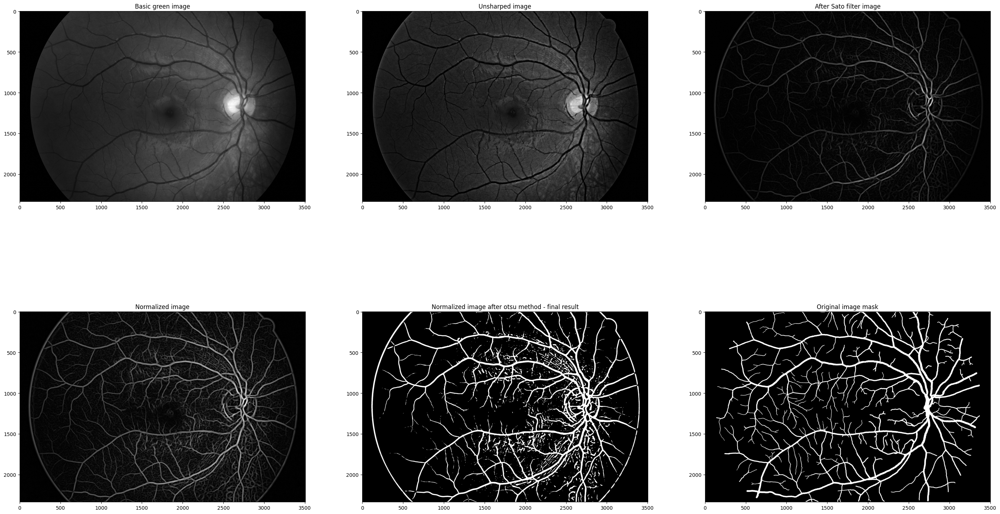

              precision    recall  f1-score   support

         0.0       0.97      0.95      0.96   7321173
         1.0       0.62      0.73      0.67    864171

    accuracy                           0.92   8185344
   macro avg       0.79      0.84      0.81   8185344
weighted avg       0.93      0.92      0.93   8185344

Error matrix:
	P		N
T	 632233 	 6934319
F	 386854 	 231938

Before averaging:
Accuracy: 92.44%
Sensitivity: 73.16%
Specificity: 94.72%

After averaging:
Average: 0.84


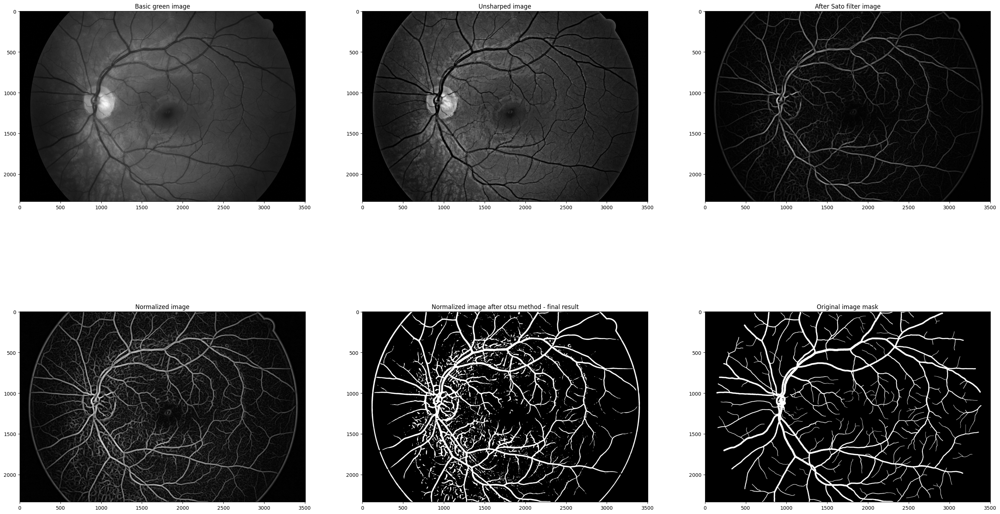

              precision    recall  f1-score   support

         0.0       0.98      0.93      0.96   7413743
         1.0       0.57      0.83      0.68    771601

    accuracy                           0.92   8185344
   macro avg       0.77      0.88      0.82   8185344
weighted avg       0.94      0.92      0.93   8185344

Error matrix:
	P		N
T	 641809 	 6925698
F	 488045 	 129792

Before averaging:
Accuracy: 92.45%
Sensitivity: 83.18%
Specificity: 93.42%

After averaging:
Average: 0.88


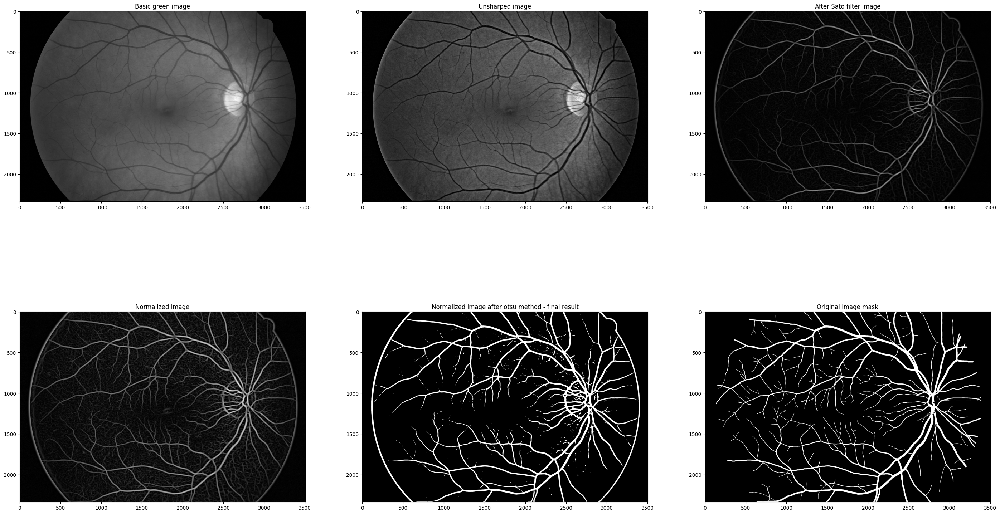

              precision    recall  f1-score   support

         0.0       0.98      0.97      0.97   7446558
         1.0       0.71      0.78      0.74    738786

    accuracy                           0.95   8185344
   macro avg       0.84      0.87      0.86   8185344
weighted avg       0.95      0.95      0.95   8185344

Error matrix:
	P		N
T	 576761 	 7211683
F	 234875 	 162025

Before averaging:
Accuracy: 95.15%
Sensitivity: 78.07%
Specificity: 96.85%

After averaging:
Average: 0.87


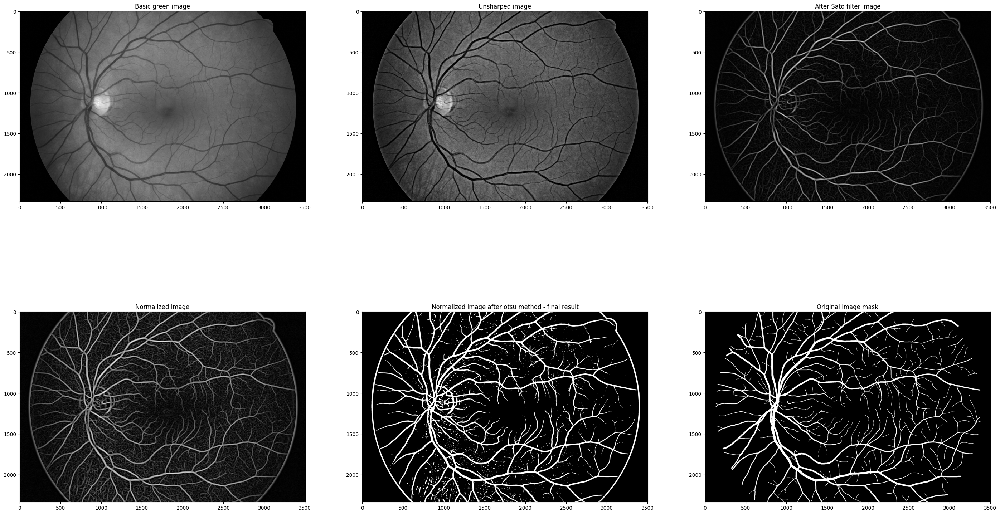

              precision    recall  f1-score   support

         0.0       0.98      0.95      0.97   7355474
         1.0       0.66      0.86      0.75    829870

    accuracy                           0.94   8185344
   macro avg       0.82      0.90      0.86   8185344
weighted avg       0.95      0.94      0.94   8185344

Error matrix:
	P		N
T	 713070 	 6990344
F	 365130 	 116800

Before averaging:
Accuracy: 94.11%
Sensitivity: 85.93%
Specificity: 95.04%

After averaging:
Average: 0.90


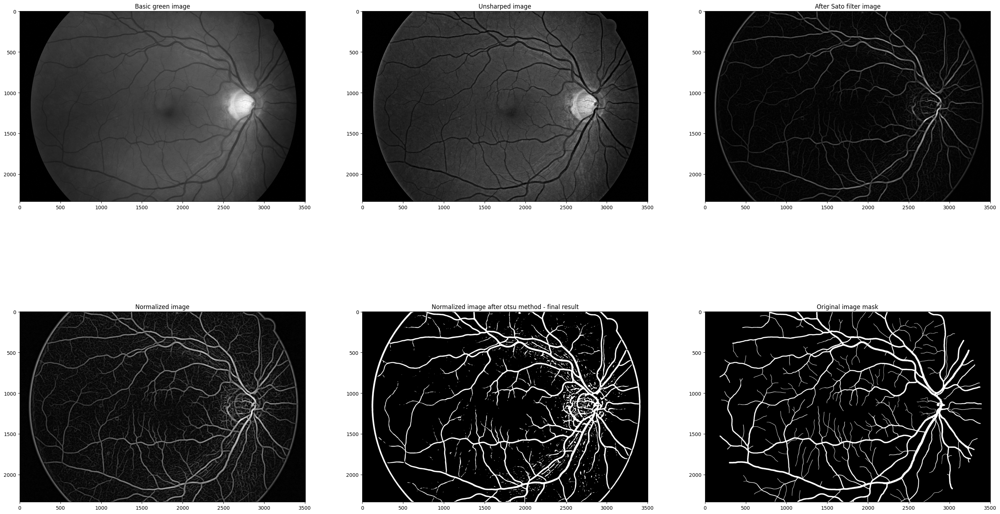

              precision    recall  f1-score   support

         0.0       0.98      0.96      0.97   7456331
         1.0       0.65      0.82      0.73    729013

    accuracy                           0.94   8185344
   macro avg       0.81      0.89      0.85   8185344
weighted avg       0.95      0.94      0.95   8185344

Error matrix:
	P		N
T	 601265 	 7128248
F	 328083 	 127748

Before averaging:
Accuracy: 94.43%
Sensitivity: 82.48%
Specificity: 95.60%

After averaging:
Average: 0.89


In [ ]:
rows = 2
cols = 3

for img, img_mask in zip(images, masks):
  fig = plt.figure(figsize=(35, 20))

  fig.add_subplot(rows, cols, 1)
  plt.imshow(img, cmap="gray")
  plt.title("Basic green image")

  unsharp_img = unsharp_mask(img, radius=20, amount=2)
  fig.add_subplot(rows, cols, 2)
  plt.imshow(unsharp_img, cmap="gray")
  plt.title("Unsharped image")

  sato_img = sato(unsharp_img)
  fig.add_subplot(rows, cols, 3)
  plt.imshow(sato_img, cmap="gray")
  plt.title("After Sato filter image")

  normalized_img = exposure.equalize_adapthist(sato_img, clip_limit = 0.01)
  fig.add_subplot(rows, cols, 4)
  plt.imshow(normalized_img, cmap="gray")
  plt.title("Normalized image")

  thresh = threshold_otsu(normalized_img)
  binary = normalized_img > thresh
  fig.add_subplot(rows, cols, 5)
  plt.imshow(binary, cmap="gray")
  plt.title("Normalized image after otsu method - final result")

  fig.add_subplot(rows, cols, 6)
  plt.imshow(img_mask, cmap="gray")
  plt.title("Original image mask")

  plt.show()

  manual_img = img_as_float(img_mask.flatten())
  result_img = binary.flatten()
  print(classification_report(manual_img, result_img))
  res_analize(img_mask, binary)

# Tradycyjne uczenie maszynowe


### Dzielenie obrazów na mniejsze części

In [ ]:
img = cv2.imread("02_h.jpg")
img =  img_as_float(img)
img_mask = cv2.imread("02_h.tif", cv2.IMREAD_GRAYSCALE)
img_mask = cv2.normalize(img_mask, None, 0, 1, cv2.NORM_MINMAX)

# Wstępne przetwarzanie
unsharp_img = unsharp_mask(img, radius=20, amount=2)
sato_img = cv2.normalize(sato(unsharp_img), None, 0, 1, cv2.NORM_MINMAX)
normalized_img = exposure.equalize_adapthist(sato_img, clip_limit = 0.01)

C:\Python310\lib\site-packages\skimage\filters\_unsharp_mask.py:11: FutureWarning: Automatic detection of the color channel was deprecated in v0.19, and `channel_axis=None` will be the new default in v0.21. Set `channel_axis=-1` explicitly to silence this warning.
  blurred = gaussian(image, sigma=radius, mode='reflect')


In [ ]:
patches_labels = extract_patches_2d(img_mask , (5,5) , max_patches = 2000000, random_state=55)
patches_img_processed = extract_patches_2d(normalized_img, (5,5), max_patches = 2000000, random_state=55)

###  Obliczanie macierzy cech danego patcha - średnia, wariancja kolorów, momenty centralne, momenty Hu

In [ ]:
def get_features(patches):
  features = []
  for patch in patches:
      patch_features = []
      mean = np.mean(patch)
      var = np.var(patch)
      grayscale_image = np.mean(patch, axis=2)
      patch_moments = skimage_moments(grayscale_image)
      hu_moments_patch = moments_hu(patch_moments).flatten()
      centroid = (patch_moments[1, 0] / patch_moments[0, 0], patch_moments[0, 1] / patch_moments[0, 0])
      central_moments_patch = moments_central(grayscale_image, centroid).flatten()
      features.append([var, mean] + hu_moments_patch.tolist() + central_moments_patch.tolist())
  return np.array(features)

### Obliczanie macierzy labelów dla opowiadających patchy

In [ ]:
labels = [int(patch[2][2]) for patch in patches_labels]
features = get_features(patches_img_processed)
labels = np.array(labels)

### Podział zbióru danych na dane do trenowania i testowania modelu

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(features, labels, test_size=0.2,  random_state=4)

### Trenowanie i wstępne testowanie modelu

In [ ]:
tree = DecisionTreeClassifier(max_depth=15,criterion='entropy')
tree = tree.fit(X_train,y_train)
y_pred = tree.predict(X_test)
report = classification_report(y_test, y_pred)
print(report)

###  Zapisywanie modelu

In [ ]:
filename = 'ML_eye_blood_vessels_model.sav'
pickle.dump(tree, open(filename, 'wb'))

### Ładowanie modelu

In [ ]:
tree = pickle.load(open('ML_eye_blood_vessels_model.sav', 'rb'))

# Testowanie modelu

<Figure size 6000x1500 with 0 Axes>

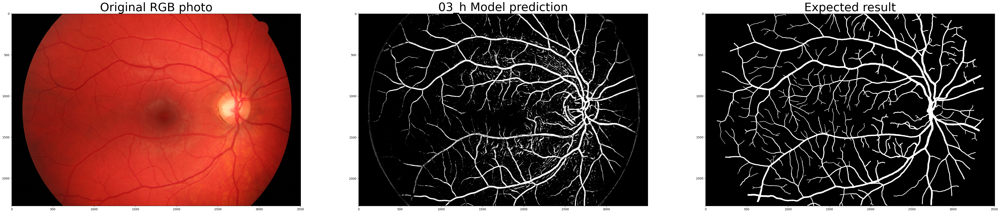

              precision    recall  f1-score   support

           0       0.96      0.97      0.96   7298392
           1       0.69      0.64      0.66    863608

    accuracy                           0.93   8162000
   macro avg       0.82      0.80      0.81   8162000
weighted avg       0.93      0.93      0.93   8162000

Error matrix:
	P		N
T	 549282 	 7048159
F	 250233 	 314326

Before averaging:
Accuracy: 93.08%
Sensitivity: 63.60%
Specificity: 96.57%

After averaging:
Average: 0.80
Value 0 occurs 7362485 times.
Value 1 occurs 799515 times.
Value 0.0 occurs 1273272 times.
Value 1.0 occurs 6912072 times.


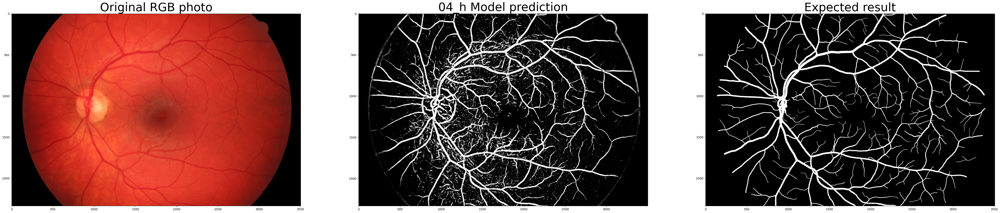

              precision    recall  f1-score   support

           0       0.98      0.93      0.95   7391299
           1       0.54      0.80      0.65    770701

    accuracy                           0.92   8162000
   macro avg       0.76      0.87      0.80   8162000
weighted avg       0.94      0.92      0.92   8162000

Error matrix:
	P		N
T	 618714 	 6870948
F	 520351 	 151987

Before averaging:
Accuracy: 91.76%
Sensitivity: 80.28%
Specificity: 92.96%

After averaging:
Average: 0.87
Value 0 occurs 7022935 times.
Value 1 occurs 1139065 times.
Value 0.0 occurs 1272332 times.
Value 1.0 occurs 6913012 times.


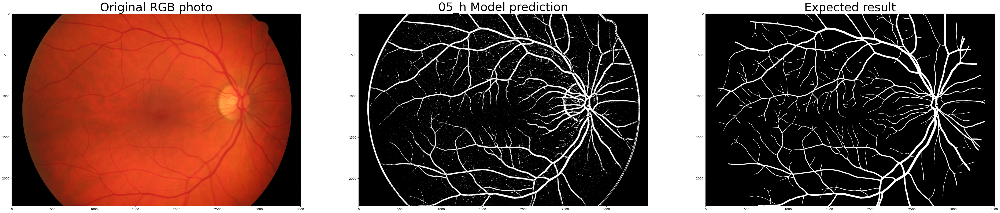

              precision    recall  f1-score   support

           0       0.98      0.96      0.97   7424189
           1       0.64      0.76      0.69    737811

    accuracy                           0.94   8162000
   macro avg       0.81      0.86      0.83   8162000
weighted avg       0.95      0.94      0.94   8162000

Error matrix:
	P		N
T	 562397 	 7105011
F	 319178 	 175414

Before averaging:
Accuracy: 93.94%
Sensitivity: 76.23%
Specificity: 95.70%

After averaging:
Average: 0.86
Value 0 occurs 7280425 times.
Value 1 occurs 881575 times.
Value 0.0 occurs 1273238 times.
Value 1.0 occurs 6912106 times.


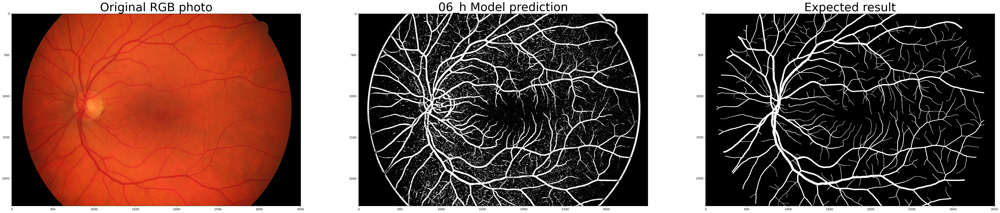

              precision    recall  f1-score   support

           0       0.98      0.89      0.94   7332833
           1       0.48      0.86      0.62    829167

    accuracy                           0.89   8162000
   macro avg       0.73      0.88      0.78   8162000
weighted avg       0.93      0.89      0.90   8162000

Error matrix:
	P		N
T	 715900 	 6557509
F	 775324 	 113267

Before averaging:
Accuracy: 89.11%
Sensitivity: 86.34%
Specificity: 89.43%

After averaging:
Average: 0.88
Value 0 occurs 6670776 times.
Value 1 occurs 1491224 times.
Value 0.0 occurs 1273760 times.
Value 1.0 occurs 6911584 times.


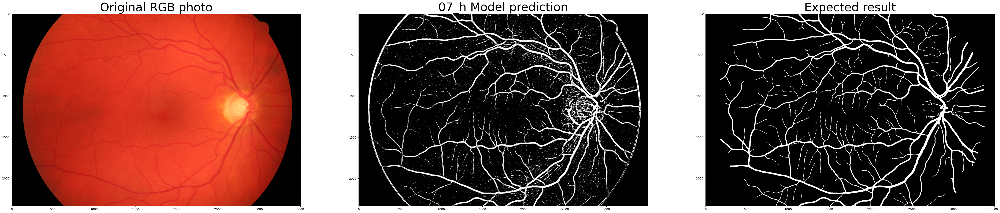

              precision    recall  f1-score   support

           0       0.98      0.95      0.96   7433610
           1       0.61      0.77      0.68    728390

    accuracy                           0.94   8162000
   macro avg       0.79      0.86      0.82   8162000
weighted avg       0.94      0.94      0.94   8162000

Error matrix:
	P		N
T	 558788 	 7077432
F	 356178 	 169602

Before averaging:
Accuracy: 93.56%
Sensitivity: 76.72%
Specificity: 95.21%

After averaging:
Average: 0.86
Value 0 occurs 7247034 times.
Value 1 occurs 914966 times.
Value 0.0 occurs 1272172 times.
Value 1.0 occurs 6913172 times.


In [ ]:
fig = plt.figure(figsize=(60, 15))
cols = 3
rows = 1
for i in range(3,8):
    fig = plt.figure(figsize=(60, 15))
    img_color = cv2.imread(f"0{i}_h.jpg")
    img_color = cv2.cvtColor(img_color, cv2.COLOR_BGR2RGB)
    img = cv2.imread(f"0{i}_h.jpg")
    img =  img_as_float(img)
    img = rgb2gray(img)
    img_mask = cv2.imread(f"0{i}_h.tif", cv2.IMREAD_GRAYSCALE)
    img_mask = cv2.normalize(img_mask, None, 0, 1, cv2.NORM_MINMAX)
    img_fov = cv2.imread(f"0{i}_h_mask.tif")
    img_fov = rgb2gray(img_fov / 255)

    unsharp_img = unsharp_mask(img, radius=20, amount=2)
    sato_img = cv2.normalize(sato(unsharp_img), None, 0, 1, cv2.NORM_MINMAX)
    normalized_img = exposure.equalize_adapthist(sato_img, clip_limit = 0.01)
    patches_img = extract_patches_2d(normalized_img, (5,5))
    patches_labels = extract_patches_2d(img_mask , (5,5))
    
    features_img = get_features(patches_img)
    labels = np.array([int(patch[2][2]) for patch in patches_labels])
    
    y_pred = tree.predict(features_img)
    report = classification_report(labels, y_pred)
    
    height, width = img_mask.shape[0], img_mask.shape[1]  # Original dimensions without the frame
    frame_size = 2  # Number of pixels in the missing frame
    new_height = height - 2 * frame_size
    new_width = width - 2 * frame_size

    # Reshape y_pred to the new shape
    y_pred_to_display = y_pred.reshape((new_height, new_width))
    
    fig.add_subplot(rows, cols, 1)
    plt.imshow(img_color)
    plt.title("Original RGB photo", fontsize=40)
    
    
    fig.add_subplot(rows, cols, 2)
    plt.imshow(y_pred_to_display, cmap="gray")
    plt.title(f"0{i}_h Model prediction", fontsize=40)
    
    fig.add_subplot(rows, cols, 3)
    plt.imshow(img_mask, cmap="gray")
    plt.title("Expected result", fontsize=40)
    
    plt.show()
    
    print(report)
    res_analize(labels, y_pred)
    # Get the unique values and their counts
    unique_values, counts = np.unique(y_pred, return_counts=True)

    # Print the unique values and their counts
    for value, count in zip(unique_values, counts):
        print(f"Value {value} occurs {count} times.")

    # Get the unique values and their counts
    unique_values, counts = np.unique(img_fov, return_counts=True)

    # Print the unique values and their counts
    for value, count in zip(unique_values, counts):
        print(f"Value {value} occurs {count} times.")



    

# Wykorzystanie głębokiej sieci neuronowej
Importowanie potrzebnych bibliotek. Podczas przetwarzania użyto fragmentów kodu z repozytorium https://github.com/karolzak/keras-unet

In [1]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import glob
import os
import sys
from PIL import Image
!pip install keras_unet
from keras_unet.utils import plot_imgs, get_patches, get_augmented, plot_segm_history, reconstruct_from_patches, plot_patches
from sklearn.model_selection import train_test_split
from keras_unet.models import custom_unet
from keras.callbacks import ModelCheckpoint
from keras.optimizers import Adam, SGD
from keras_unet.metrics import iou, iou_thresholded
from keras_unet.losses import jaccard_distance

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
-----------------------------------------
keras-unet init: TF version is >= 2.0.0 - using `tf.keras` instead of `Keras`
-----------------------------------------


Wczytywanie zdjęć i masek eksperckich

In [2]:
orgs = sorted(glob.glob("*.jpg"))
masks = sorted(list(map(lambda x: x.replace(".jpg", ".tif"), orgs)))
print(orgs)
print(masks)

['01_h.jpg', '02_h.jpg', '03_h.jpg', '04_h.jpg', '05_h.jpg', '06_h.jpg', '07_h.jpg', '08_h.jpg', '09_h.jpg', '10_h.jpg', '11_h.jpg', '12_h.jpg', '13_h.jpg', '14_h.jpg', '15_h.jpg']
['01_h.tif', '02_h.tif', '03_h.tif', '04_h.tif', '05_h.tif', '06_h.tif', '07_h.tif', '08_h.tif', '09_h.tif', '10_h.tif', '11_h.tif', '12_h.tif', '13_h.tif', '14_h.tif', '15_h.tif']


Wstępne przetwarzanie zdjęć (odcień zielony), normalizacja

In [5]:
imgs_list = []
masks_list = []
for image, mask in zip(orgs, masks):
    img = np.array(Image.open(image))
    img[:,:,0] = 0
    img[:,:,2] = 0
    img = rgb2gray(img)
    imgs_list.append(img)
    masks_list.append(np.array(Image.open(mask)))

imgs_np = np.asarray(imgs_list)
masks_np = np.asarray(masks_list)
x = np.asarray(imgs_np, dtype=np.float32)/255
y = np.asarray(masks_np, dtype=np.float32)/255
y = y.reshape(y.shape[0], y.shape[1], y.shape[2], 1)
x = x.reshape(x.shape[0], x.shape[1], x.shape[2], 1)
print(x.shape, y.shape)


(15, 2336, 3504, 1) (15, 2336, 3504, 1)


# Przygotowanie fragmentów zdjęć
Podział zdjęć orginałów oraz masek na fragmenty o rozmiarze 256x256. Na tych fragmentach będzie trenowana sieć neuronowa.

In [6]:
x_crops = get_patches(
    img_arr=x, # required - array of images to be cropped
    size=256, # default is 256
    stride=256) # default is 256

print("x_crops shape: ", str(x_crops.shape))

y_crops = get_patches(
    img_arr=y, # required - array of images to be cropped
    size=256, # default is 256
    stride=256) # default is 256

print("y_crops shape: ", str(y_crops.shape))

x_crops shape:  (1215, 256, 256, 1)
y_crops shape:  (1215, 256, 256, 1)


Podział na zbiór trenujący i testowy

In [7]:
x_train, x_val, y_train, y_val = train_test_split(x_crops, y_crops, test_size=0.9, random_state=0)
print("x_train: ", x_train.shape)
print("y_train: ", y_train.shape)
print("x_val: ", x_val.shape)
print("y_val: ", y_val.shape)

x_train:  (121, 256, 256, 1)
y_train:  (121, 256, 256, 1)
x_val:  (1094, 256, 256, 1)
y_val:  (1094, 256, 256, 1)


Modyfikacja podzielonych fragmentów. Obrót, pochylenie, obrócenie

In [ ]:
train_gen = get_augmented(
    x_train, y_train, batch_size=2,
    data_gen_args = dict(
        rotation_range=5.,
        width_shift_range=0.05,
        height_shift_range=0.05,
        shear_range=40,
        zoom_range=0.2,
        horizontal_flip=True,
        vertical_flip=False,
        fill_mode='constant'
    ))

Przykładowe fragmenty na których trenowano sieć

(2, 256, 256, 1) (2, 256, 256, 1)


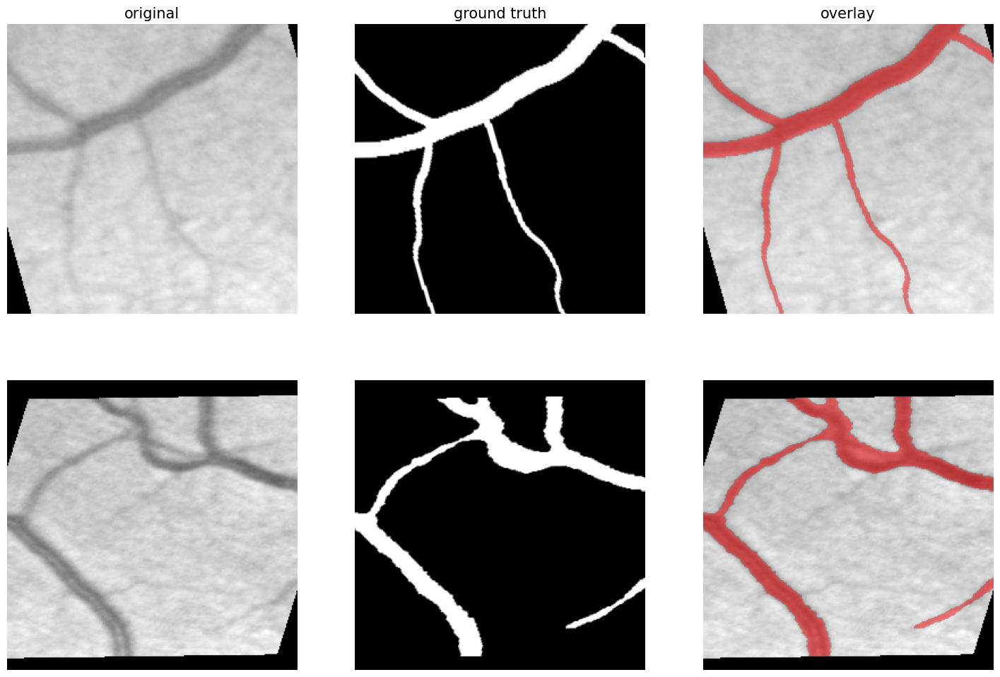

In [ ]:
sample_batch = next(train_gen)
xx, yy = sample_batch
print(xx.shape, yy.shape)

plot_imgs(org_imgs=xx, mask_imgs=yy, nm_img_to_plot=2, figsize=6)

# Model głębokiej sieci neuronowej
Przygotowanie modelu


In [ ]:
input_shape = x_train[0].shape

model = custom_unet(
    input_shape,
    filters=32,
    use_batch_norm=True,
    dropout=0.3,
    dropout_change_per_layer=0.0,
    num_layers=4
)

Podsumowanie informacji na temat modelu

In [ ]:
model.summary()

Wczytywanie sieci z pliku


In [ ]:
model_filename = 'segm_model_v3.h5'
callback_checkpoint = ModelCheckpoint(
    model_filename, 
    verbose=1, 
    monitor='val_loss', 
    save_best_only=True,
)

Kompilacja modelu

In [ ]:
model.compile(
    optimizer=Adam(), 
    #optimizer=SGD(lr=0.01, momentum=0.99),
    loss='binary_crossentropy',
    #loss=jaccard_distance,
    metrics=[iou, iou_thresholded]
)

Trenowanie sieci 

In [ ]:
history = model.fit_generator(
    train_gen,
    steps_per_epoch=200,
    epochs=50,
    
    validation_data=(x_val, y_val),
    callbacks=[callback_checkpoint]
)

Epoch 1/50


<ipython-input-18-0384b6e5f6c2>:1: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  history = model.fit_generator(


200/200 [==============================] - ETA: 0s - loss: 0.4170 - iou: 0.1210 - iou_thresholded: 0.2721
Epoch 1: val_loss improved from inf to 2.15729, saving model to segm_model_v3.h5
200/200 [==============================] - 46s 159ms/step - loss: 0.4170 - iou: 0.1210 - iou_thresholded: 0.2721 - val_loss: 2.1573 - val_iou: 0.0569 - val_iou_thresholded: 0.0560
Epoch 2/50
200/200 [==============================] - ETA: 0s - loss: 0.1844 - iou: 0.2328 - iou_thresholded: 0.3844
Epoch 2: val_loss improved from 2.15729 to 0.41760, saving model to segm_model_v3.h5
200/200 [==============================] - 24s 120ms/step - loss: 0.1844 - iou: 0.2328 - iou_thresholded: 0.3844 - val_loss: 0.4176 - val_iou: 0.0703 - val_iou_thresholded: 0.0475
Epoch 3/50
200/200 [==============================] - ETA: 0s - loss: 0.1394 - iou: 0.3079 - iou_thresholded: 0.4506
Epoch 3: val_loss did not improve from 0.41760
200/200 [==============================] - 24s 120ms/step - loss: 0.1394 - iou: 0.3079 

Wykresy przedstawiające historię treningu

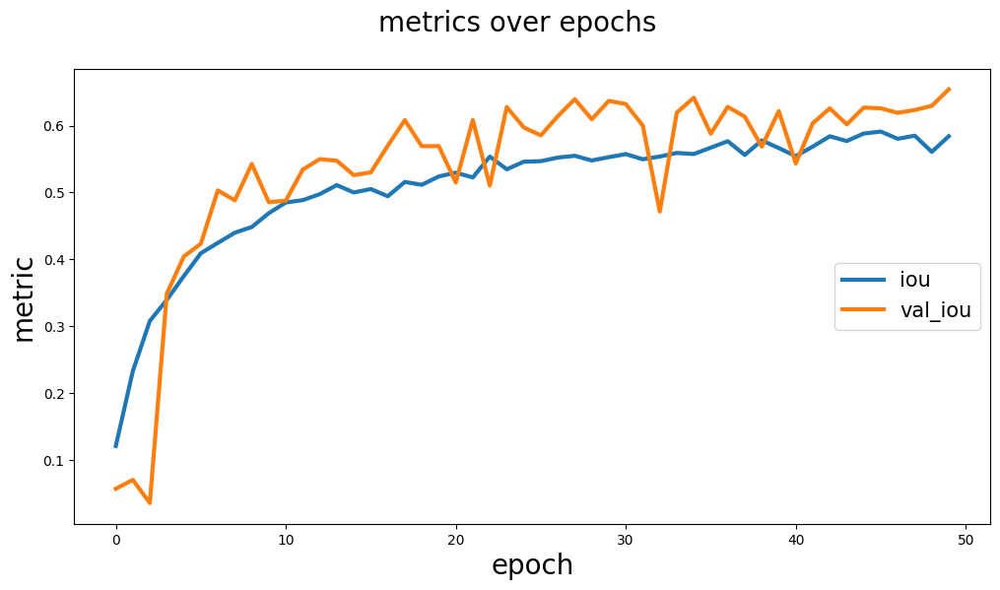

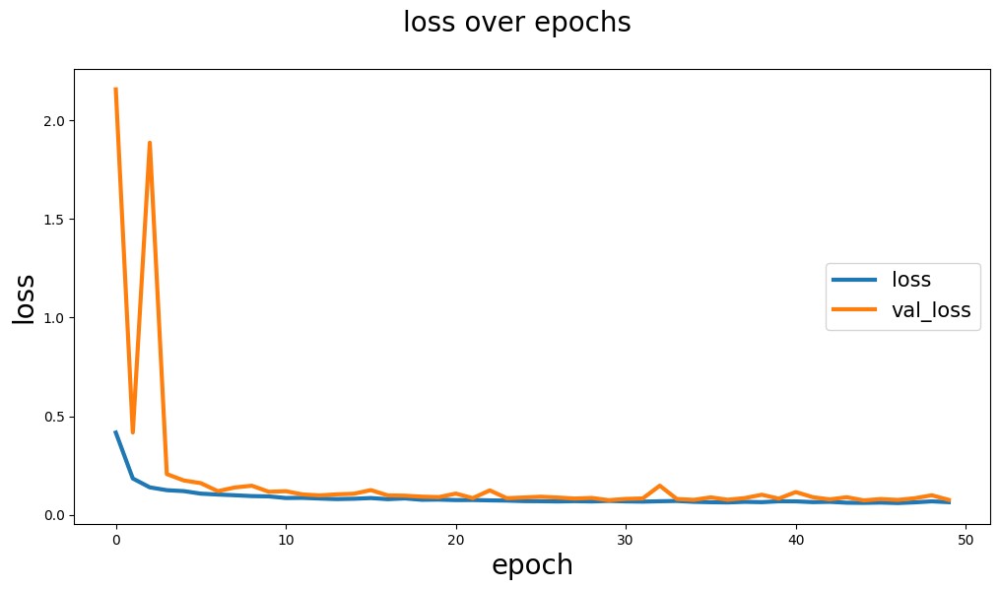

In [ ]:
plot_segm_history(history)

# Załadowanie modelu, predykcja oraz analiza
Wytrenowana sieć jest sprawdzana jest na podstawie całych orginalnych zdjęć

1/1 [==============================] - 0s 40ms/step


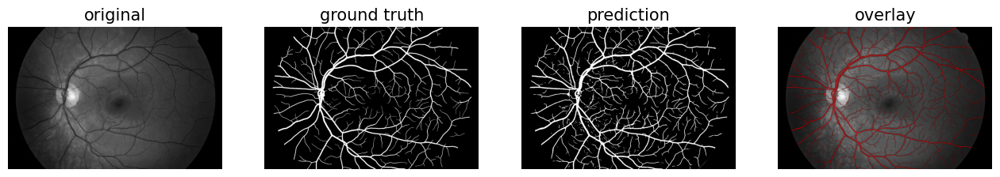

              precision    recall  f1-score   support

           0       0.97      0.99      0.98   7225805
           1       0.93      0.75      0.83    959539

    accuracy                           0.96   8185344
   macro avg       0.95      0.87      0.91   8185344
weighted avg       0.96      0.96      0.96   8185344

Error matrix:
	P		N
T	 720820 	 7175024
F	 238719 	 50781

Before averaging:
Accuracy: 96.46%
Sensitivity: 93.42%
Specificity: 96.78%

After averaging:
Average: 0.95
1/1 [==============================] - 0s 54ms/step


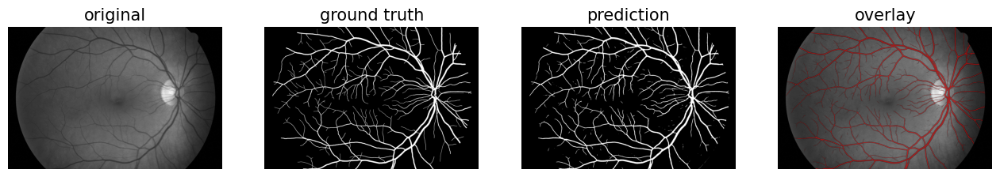

              precision    recall  f1-score   support

           0       0.98      0.99      0.99   7384536
           1       0.90      0.83      0.86    800808

    accuracy                           0.97   8185344
   macro avg       0.94      0.91      0.92   8185344
weighted avg       0.97      0.97      0.97   8185344

Error matrix:
	P		N
T	 663185 	 7308935
F	 137623 	 75601

Before averaging:
Accuracy: 97.40%
Sensitivity: 89.77%
Specificity: 98.15%

After averaging:
Average: 0.94
1/1 [==============================] - 0s 53ms/step


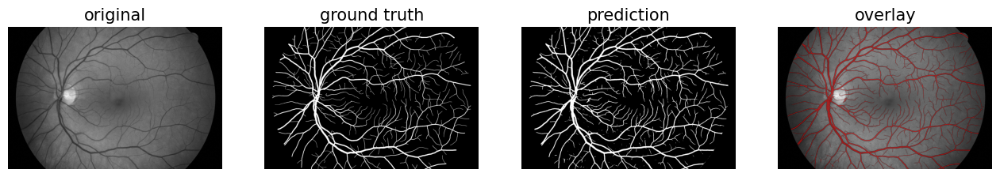

              precision    recall  f1-score   support

           0       0.97      0.99      0.98   7199198
           1       0.94      0.79      0.86    986146

    accuracy                           0.97   8185344
   macro avg       0.96      0.89      0.92   8185344
weighted avg       0.97      0.97      0.97   8185344

Error matrix:
	P		N
T	 779622 	 7148950
F	 206524 	 50248

Before averaging:
Accuracy: 96.86%
Sensitivity: 93.95%
Specificity: 97.19%

After averaging:
Average: 0.96
1/1 [==============================] - 0s 55ms/step


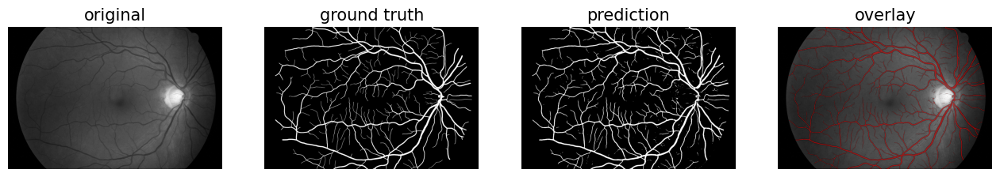

              precision    recall  f1-score   support

           0       0.98      0.99      0.99   7348257
           1       0.92      0.80      0.86    837087

    accuracy                           0.97   8185344
   macro avg       0.95      0.90      0.92   8185344
weighted avg       0.97      0.97      0.97   8185344

Error matrix:
	P		N
T	 672202 	 7291446
F	 164885 	 56811

Before averaging:
Accuracy: 97.29%
Sensitivity: 92.21%
Specificity: 97.79%

After averaging:
Average: 0.95
1/1 [==============================] - 0s 53ms/step


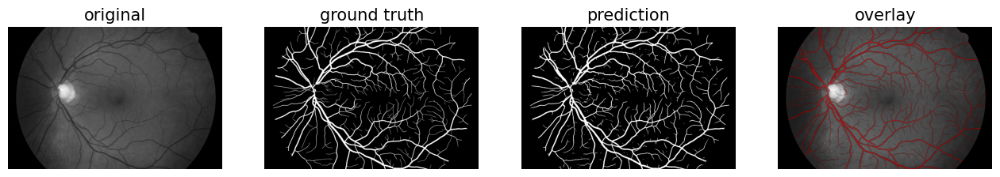

              precision    recall  f1-score   support

           0       0.98      0.99      0.98   7258354
           1       0.93      0.82      0.87    926990

    accuracy                           0.97   8185344
   macro avg       0.95      0.91      0.93   8185344
weighted avg       0.97      0.97      0.97   8185344

Error matrix:
	P		N
T	 760806 	 7197533
F	 166184 	 60821

Before averaging:
Accuracy: 97.23%
Sensitivity: 92.60%
Specificity: 97.74%

After averaging:
Average: 0.95


In [ ]:
model.load_weights(model_filename)

for i in range(3,8):
  y_reshaped = y[i].reshape(1, y[i].shape[0], y[i].shape[1], y[i].shape[2])
  x_reshaped = x[i].reshape(1, x[i].shape[0], x[i].shape[1], x[i].shape[2])
  y_pred = model.predict(x_reshaped)
  final_pred = (y_pred > 0.2).astype(np.uint8)
  plot_imgs(org_imgs=x_reshaped, mask_imgs=y_reshaped, pred_imgs=final_pred, nm_img_to_plot=1)
  report = classification_report(final_pred.flatten(), y_reshaped.flatten())
  print(report)
  res_analize(y_reshaped, final_pred)